# Exercise 7 - Monte Carlo Localization

In this assignment you need to implement a particle filter algorithm for localizing a robot in a given map. 
The data for this exercise is recorded on a differential drive robot equipped with a 2D laser scanner that moves in the following environment:

In [44]:
# -*- coding: utf-8 -*-
import pickle

import matplotlib.pyplot as plt
import numpy as np


def world2map(pose, gridmap, map_res):
    max_y = np.size(gridmap, 0) - 1
    new_pose = np.zeros_like(pose)
    new_pose[0] = np.round(pose[0] / map_res)
    new_pose[1] = max_y - np.round(pose[1] / map_res)
    return new_pose.astype(int)


def v2t(pose):
    c = np.cos(pose[2])
    s = np.sin(pose[2])
    tr = np.array([[c, -s, pose[0]], [s, c, pose[1]], [0, 0, 1]])
    return tr


def t2v(tr):
    x = tr[0, 2]
    y = tr[1, 2]
    th = np.arctan2(tr[1, 0], tr[0, 0])
    v = np.array([x, y, th])
    return v


def ranges2points(ranges, angles):
    # rays within range
    max_range = 80
    idx = (ranges < max_range) & (ranges > 0)
    # 2D points
    points = np.array([
        np.multiply(ranges[idx], np.cos(angles[idx])),
        np.multiply(ranges[idx], np.sin(angles[idx]))
    ])
    # homogeneous points
    points_hom = np.append(points, np.ones((1, np.size(points, 1))), axis=0)
    return points_hom


def ranges2cells(r_ranges, r_angles, w_pose, gridmap, map_res):
    # ranges to points
    r_points = ranges2points(r_ranges, r_angles)
    w_P = v2t(w_pose)
    w_points = np.matmul(w_P, r_points)
    # world to map
    m_points = world2map(w_points, gridmap, map_res)
    m_points = m_points[0:2, :]
    return m_points


def poses2cells(w_pose, gridmap, map_res):
    # covert to map frame
    m_pose = world2map(w_pose, gridmap, map_res)
    return m_pose


def init_uniform(num_particles, img_map, map_res):
    particles = np.zeros((num_particles, 4))
    particles[:, 0] = np.random.rand(num_particles) * np.size(img_map,
                                                              1) * map_res
    particles[:, 1] = np.random.rand(num_particles) * np.size(img_map,
                                                              0) * map_res
    particles[:, 2] = np.random.rand(num_particles) * 2 * np.pi
    particles[:, 3] = 1.0
    return particles


def plot_particles(particles, img_map, map_res):
    plt.matshow(img_map, cmap="gray")
    max_y = np.size(img_map, 0) - 1
    xs = np.copy(particles[:, 0]) / map_res
    ys = max_y - np.copy(particles[:, 1]) / map_res
    plt.plot(xs, ys, '.b')
    plt.xlim(0, np.size(img_map, 1))
    plt.ylim(0, np.size(img_map, 0))
    plt.show()


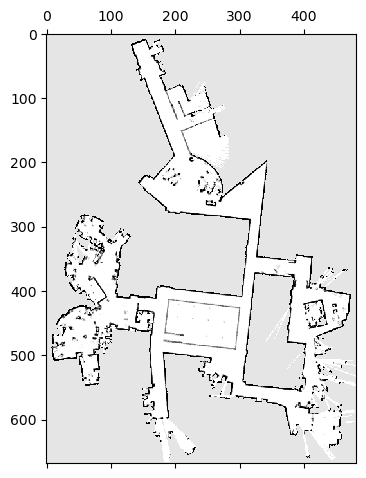

In [45]:
import pickle
import numpy as np
import matplotlib.pyplot as plt
import ex7 as ex
%matplotlib inline

data = pickle.load(open("dataset_mit_csail.p", "rb"))

plt.matshow(data['img_map'], cmap="gray")
plt.show()

The following data is provided in `data`:

- *img_map* is the image of the environment where the robot must localize
- *likelihood_map* is the likelihood map defined over the environment and used for computing the weights of the particles
- *odom* is the noisy odometry readings observed by the robot during navigation in the form: $\delta_{rot1}, \delta_{trans}, \delta_{rot2}$
- *gt_odom* is the ground truth odometry, you may want to use it for checking your results
- *z* are the laser range measurements (37 beams $\rho_i, \phi_i$) obtained by the robot during navigation, where $\rho_i$ is the range and $\theta_i$ the corresponding firing angle defined wrt the robot orientation

You can access the `data` as follows:

In [46]:
# get odometry reading at timestep 25
odom_25 = data['odom'][25]
print("Odom at step 25 is: ", odom_25)

# get ground truth odometry reading at timestep 25
odom_gt_25 = data['gt_odom'][25]
print("True odom at step 25 is: ", odom_25)

# get observed scan at timestep 10
z_10 = data['z'][10]
print("Angles at step 10 is: ", z_10[0,:])
print("Ranges at step 10 is: ", z_10[1,:])

Odom at step 25 is:  [ 0.11378333  0.50803543 -0.18586595]
True odom at step 25 is:  [ 0.11378333  0.50803543 -0.18586595]
Angles at step 10 is:  [-1.570796e+00 -1.483526e+00 -1.396256e+00 -1.308986e+00 -1.221716e+00
 -1.134446e+00 -1.047176e+00 -9.599060e-01 -8.726360e-01 -7.853660e-01
 -6.980960e-01 -6.108260e-01 -5.235560e-01 -4.362860e-01 -3.490160e-01
 -2.617460e-01 -1.744760e-01 -8.720600e-02  6.400000e-05  8.733400e-02
  1.746040e-01  2.618740e-01  3.491440e-01  4.364140e-01  5.236840e-01
  6.109540e-01  6.982240e-01  7.854940e-01  8.727640e-01  9.600340e-01
  1.047304e+00  1.134574e+00  1.221844e+00  1.309114e+00  1.396384e+00
  1.483654e+00  1.570924e+00]
Ranges at step 10 is:  [ 3.    2.99  1.33  1.23  1.16  1.14  1.34  1.43  1.4   2.94  3.    3.07
  3.2   3.22  3.59  3.7   3.86  2.75 81.91  1.65  1.68  1.81 81.91 81.91
  4.73  4.76  3.76  4.18  2.3   2.31  5.7   2.33  2.41  4.23  4.09  4.02
 81.91]


## 7.1 Motion update [1.0]

The `sample_motion_model_odometry` function defines the sampling-based odometry motion model. 

This function takes as input:

- the initial pose of the robot $x_{t-1} = [x,y,\theta]$
- the odometry readings $u_t = [\delta_{rot1}, \delta_{trans}, \delta_{rot2}]$ 
- the noise parameters $\mathbf{\alpha} = [0.1, 0.1, 0.1, 0.1]$

The output is a new (sampled) pose predicted by the motion model.

Implement the `sample_motion_model_odometry` function and verify that it is correct for some test input. 

You **can** re-use the your implementation from Exercise 3. 

In [47]:
import numpy as np

def sample_motion_model_odometry(x_t_minus_1, u_t, alpha):
    """
    Samples a new pose based on the odometry motion model.
    
    Args:
        x_t_minus_1 (numpy array): Previous pose [x, y, theta].
        u_t (numpy array): Odometry readings [delta_rot1, delta_trans, delta_rot2].
        alpha (list): Noise parameters [alpha1, alpha2, alpha3, alpha4].
    
    Returns:
        numpy array: New sampled pose [x', y', theta'].
    """
    # Extract previous pose
    x, y, theta = x_t_minus_1
    
    # Extract odometry readings
    delta_rot1, delta_trans, delta_rot2 = u_t
    
    # Add noise to the odometry readings
    std_rot1 = np.sqrt(alpha[0] * delta_rot1**2 + alpha[1] * delta_trans**2)
    std_trans = np.sqrt(alpha[2] * delta_trans**2 + alpha[3] * (delta_rot1**2 + delta_rot2**2))
    std_rot2 = np.sqrt(alpha[0] * delta_rot2**2 + alpha[1] * delta_trans**2)
    
    noisy_delta_rot1 = delta_rot1 + np.random.normal(0, std_rot1)
    noisy_delta_trans = delta_trans + np.random.normal(0, std_trans)
    noisy_delta_rot2 = delta_rot2 + np.random.normal(0, std_rot2)
    
    # Compute the new pose
    x_new = x + noisy_delta_trans * np.cos(theta + noisy_delta_rot1)
    y_new = y + noisy_delta_trans * np.sin(theta + noisy_delta_rot1)
    theta_new = theta + noisy_delta_rot1 + noisy_delta_rot2
    
    return np.array([x_new, y_new, theta_new])

# Example inputs
x_t_minus_1 = np.array([0.0, 0.0, 0.0])  # Initial pose
u_t = np.array([0.1, 1.0, 0.05])         # Odometry readings
alpha = [0.1, 0.1, 0.1, 0.1]             # Noise parameters

# Sample a new pose
new_pose = sample_motion_model_odometry(x_t_minus_1, u_t, alpha)
print("New pose:", new_pose)


New pose: [ 0.81197913 -0.13355087  0.27319229]


## 7.2 Compute weights [3.0]

The `compute_weights` function is responsible for computing the importance weight for each particle according to the observation model, i.e.,

$$w_{i,t} = \eta\,p(z_{t}|x_{i,t}).$$

The motion model is obtained by querying the likelihood map defined over the environment in the endpoints of the laser scan ranges.

The available `ranges2cells` function computes the endpoints of raw scans $(\rho, \phi)$ into map coordinates.

Implement the `compute_weights` function and verify that it is correct for some test input. 

In [48]:
def compute_weights(particles, z, likelihood_map, map_res):
    """
    Compute the weights for each particle based on the laser scan measurements.
    
    Parameters:
    - particles: Array of particles, each particle is [x, y, theta, weight]
    - z: Laser range measurements (ranges and angles)
    - likelihood_map: The likelihood map of the environment
    - map_res: The resolution of the map
    
    Returns:
    - weights: Array of weights for each particle
    """
    num_particles = particles.shape[0]
    weights = np.zeros(num_particles)
    
    # Extract ranges and angles from the laser measurements
    ranges = z[0]  # Assuming z[0] contains the ranges
    angles = z[1]  # Assuming z[1] contains the angles
    
    for i in range(num_particles):
        # Get the current particle pose
        particle_pose = particles[i, :3]  # [x, y, theta]
        
        # Convert ranges to map cells
        laser_cells = ranges2cells(ranges, angles, particle_pose, likelihood_map, map_res)
        
        # Compute the weight based on the likelihood map
        weight = 1.0
        for cell in laser_cells.T:  # Iterate over each laser endpoint
            x_cell, y_cell = cell
            if 0 <= x_cell < likelihood_map.shape[1] and 0 <= y_cell < likelihood_map.shape[0]:
                weight *= likelihood_map[y_cell, x_cell]  # Multiply the likelihood for this cell
        
        weights[i] = weight
    
    # Normalize weights
    weights += 1e-300  # Avoid division by zero
    weights /= np.sum(weights)  # Normalize to sum to 1
    
    return weights

# Sample particles (x, y, theta, weight)
particles = np.array([[2.0, 3.0, np.pi/4, 0.0],
                      [1.5, 2.5, np.pi/2, 0.0]])

# Sample laser range measurements (ranges and angles)
ranges = np.array([3.0, 2.5, 1.0, 1.5])  # Example ranges
angles = np.array([-np.pi/2, -np.pi/4, 0, np.pi/4]) 
print(ranges, "ranges", angles, "angles")

[3.  2.5 1.  1.5] ranges [-1.57079633 -0.78539816  0.          0.78539816] angles


## 7.3 Resampling [3.0]

The `resample` function is responsible for re-sampling particles according to their weight (the higher the more likely to be samples) and, thus, “kills” the particles with low weight.

Implement the `resample` function and verify that it is correct for some test input. 

In [49]:
def resample(particles, weights):
    """
    Resample particles according to their weights.
    
    Parameters:
    - particles: Array of particles, each particle is [x, y, theta, weight]
    - weights: Array of weights for each particle
    
    Returns:
    - resampled_particles: Array of resampled particles
    """
    num_particles = particles.shape[0]
    resampled_particles = np.zeros_like(particles)
    
    # Normalize weights
    weights += 1e-300  # Avoid division by zero
    weights /= np.sum(weights)  # Normalize to sum to 1
    
    # Cumulative sum of weights
    cumulative_sum = np.cumsum(weights)
    
    # Resampling
    for i in range(num_particles):
        # Draw a random number
        random_value = np.random.rand()
        
        # Find the index of the particle to sample
        index = np.searchsorted(cumulative_sum, random_value)
        
        # Assign the selected particle to the resampled particles
        resampled_particles[i] = particles[index]
    
    return resampled_particles

# Sample particles (x, y, theta, weight)
particles = np.array([[2.0, 3.0, 0.0],
                      [1, 3.0, 4.],
                      [2.0, 5.0, 0.0]])



# Sample weights (must sum to 1 after normalization)
weights = np.array([0.2, 0.8, 0.0])  # Example weights

# Resample particles
resampled_particles = resample(particles, weights)

print("Resampled Particles:")
print(resampled_particles)

Resampled Particles:
[[1. 3. 4.]
 [1. 3. 4.]
 [1. 3. 4.]]


## 7.4 Localization [3.0]

Once you complete all the above functions, implement the main procedure of Monte Carlo localization `mc_localization` which recursively estimate the position of the robot using the odometry data and the laser scans.

Consider 5000 particles that are intialized uniformly over the environment. 

The map resolution is 0.1 and each particle is a $(x,y,\theta)$ pose.

Plot the belief about the position of the robot after the sequence of odometry readings and laser scans provided in `data` by using the `plot_particles` function.

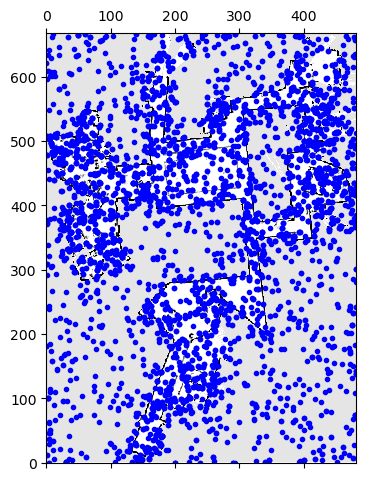

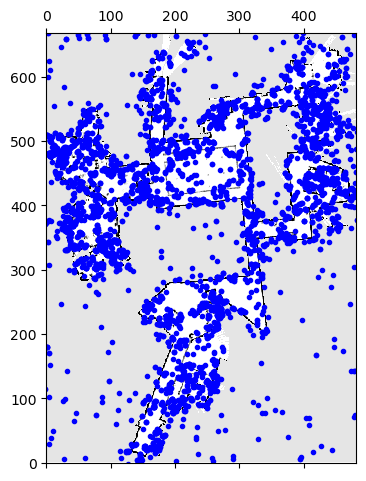

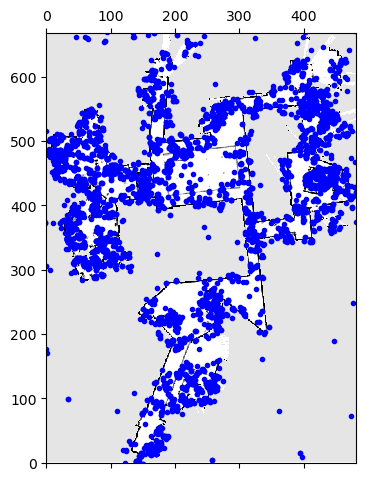

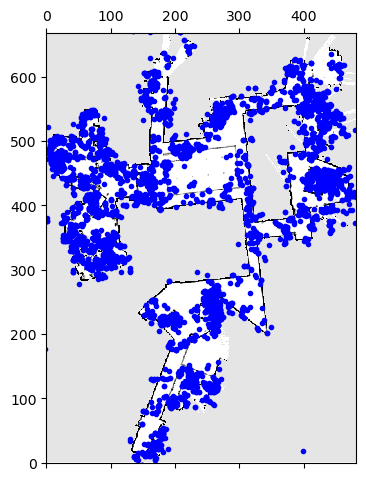

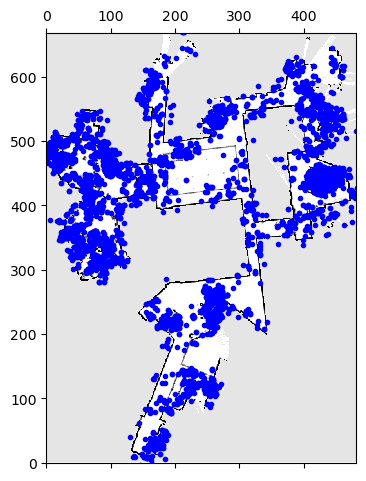

...

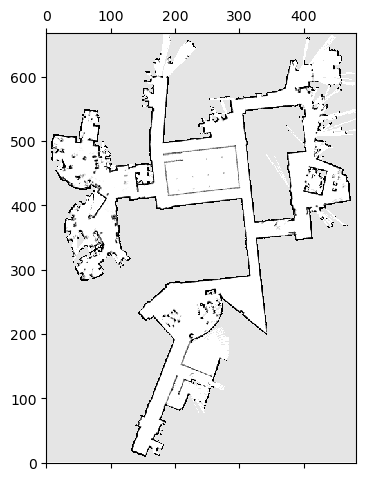

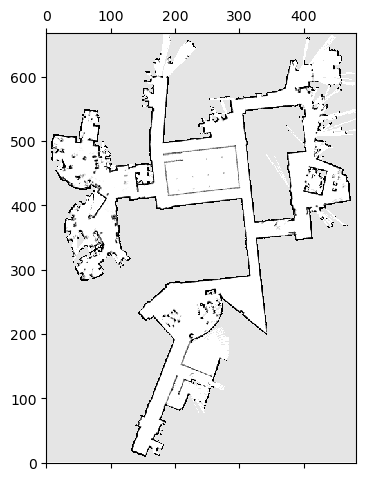

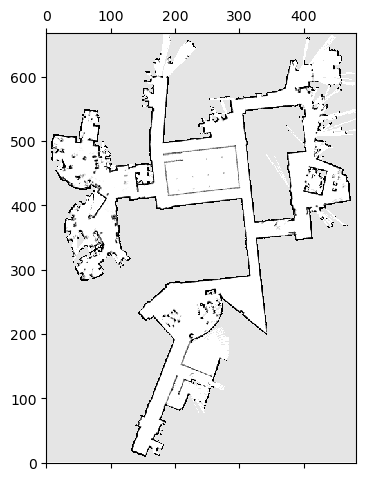

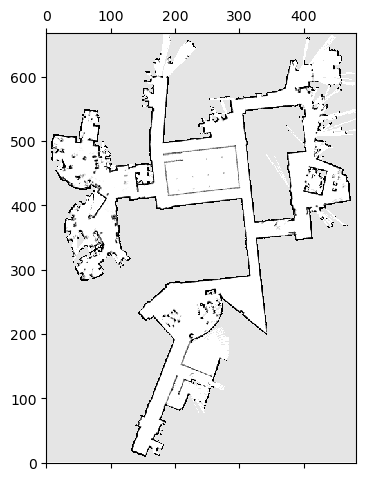

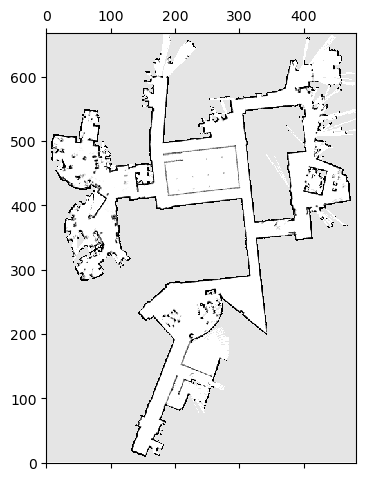

In [50]:
import numpy as np
import pickle
import matplotlib.pyplot as plt
import imageio

def mc_localization(num_particles, map_res, img_map, likelihood_map, odom, laser_data, alpha):
    """
    Perform Monte Carlo Localization.
    
    Parameters:
    - num_particles: Number of particles to use
    - map_res: Resolution of the map
    - img_map: The image of the environment
    - likelihood_map: The likelihood map of the environment
    - odom: Noisy odometry readings
    - laser_data: Laser range measurements
    - alpha: Noise parameters for the motion model
    
    Returns:
    - particles: The final set of particles after processing all data
    """
    # Initialize particles uniformly
    particles = init_uniform(num_particles, img_map, map_res)

    # Store frames for GIF
    frames = []

    # Iterate over each time step
    for t in range(len(odom)):
        # Get the current odometry and laser scan data
        u_t = odom[t]  # Current odometry readings
        z_t = laser_data[t]  # Current laser scan measurements
        
        # Motion update: sample new poses for each particle
        for i in range(num_particles):
            particles[i, :3] = sample_motion_model_odometry(particles[i, :3], u_t, alpha)
        
        # Compute weights for each particle based on the laser scan
        weights = compute_weights(particles, z_t, likelihood_map, map_res)

        # Resample particles based on their weights
        particles = resample(particles, weights)

        # Plot 
        fig, ax = plt.subplots()
        # plot_particles(particles, img_map, map_res, ax=ax)  # Assuming plot_particles can take an `ax`
        
        # print(odom, t)
        plt.title(f'Time Step {t}')
        
        # Save frame as image array
        fig.canvas.draw()
        frame = np.array(fig.canvas.renderer.buffer_rgba())
        frames.append(frame)

        plt.close(fig)
        # Visualize the particle distribution (useful for debugging)
        plot_particles(particles, img_map, map_res)

    # Create GIF
    imageio.mimsave("particle_filter.gif", frames, duration=0.1)
    
    return particles

# Load the data
data = pickle.load(open("dataset_mit_csail.p", "rb"))

# Parameters
num_particles = 5000
map_res = 0.1
alpha = [0.1, 0.1, 0.1, 0.1]  # Noise parameters

# Run the Monte Carlo Localization
particles = mc_localization(num_particles, map_res, data['img_map'], data['likelihood_map'], data['odom'], data['z'], alpha)

In [51]:
def plot_particles(particles, img_map, map_res):
    """
    Plot the particles on the environment map.
    
    Parameters:
    - particles: List of particles (each particle is a [x, y, theta]).
    - img_map: The environment map (gray-scale image).
    - map_res: Map resolution.
    """
    # Extract the x, y coordinates of the particles
    x_coords = [p[0] for p in particles]
    y_coords = [p[1] for p in particles]
    
    # Plot the particles
    plt.figure(figsize=(10, 10))
    plt.imshow(img_map, cmap='gray')
    plt.scatter(x_coords, y_coords, s=1, c='red', alpha=0.5)
    plt.show()

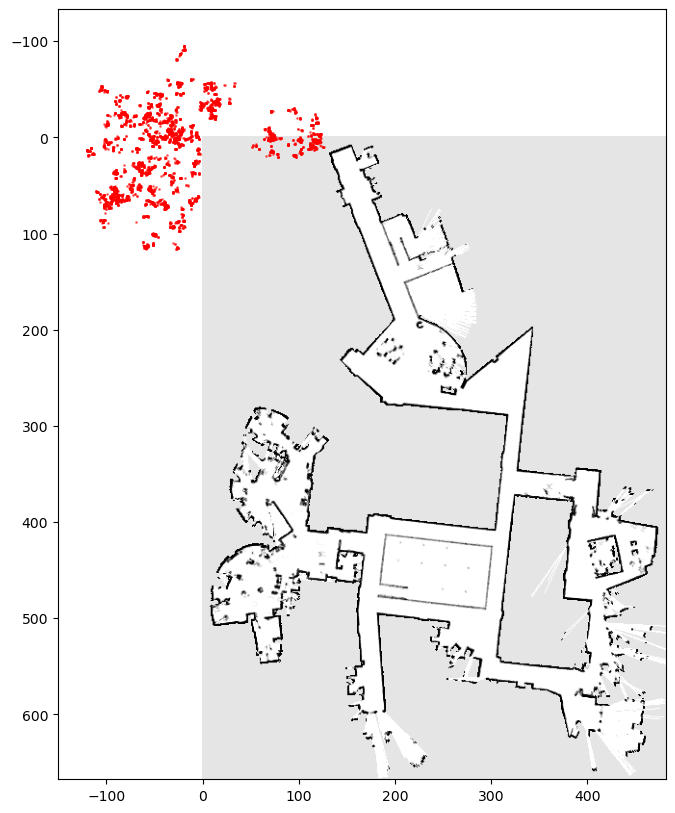

In [52]:
x_coords = [p[0] for p in particles]
y_coords = [p[1] for p in particles]

# Assuming you have run the mc_localization function and have the particles
plot_particles(particles, data['img_map'], map_res)